<a href="https://colab.research.google.com/github/Maulmise/text_clustering_mysapkbkn/blob/main/Clustering_dan_Aspek_Ulasan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**ANALISIS PENGELOMPOKAN ULASAN PENGGUNA MENGGUNAKAN K-MEANS CLUSTERING UNTUK EVALUASI APLIKASI MY SAPK BKN**

M Ighfar Maulana 205150400111055

# Data Preprocessing

In [ ]:
import pandas as pd
data = pd.read_csv('Downloads/mysapk_raw_dataset7.csv')
data

,userName,score,at,content
0,Syaidati Hartinah,1,2023-08-29 04:00:17,Saya komplain karna gk bisa login berkali kali
1,Asep Samsul Umam,5,2023-08-28 14:24:23,"Sudah beberapa kali pembaruan, aplikasi berjal..."
2,saep udin,5,2023-08-27 11:05:50,My sapk bkn sangat OK
3,ANDTARA _ DHIK4,5,2023-08-27 09:54:27,Oke Punya
4,Junaedi Tarihoran,1,2023-08-26 05:23:54,Mohon aplikasi di update untuk perbaikan tampi...
...,...,...,...,...
3316,Ifin Marlonk,1,2021-07-15 04:43:19,"Apkikasinya gak ada menu registrasi/daftar, ma..."
3317,Engkos Kosasih,5,2021-07-15 02:39:14,P8😂😂💩😭😇🎂⁸dc😶😶g ⁹66🙏💦😅699cj⁸⁸on tar u6
3318,Karsinah Karsinah,4,2021-07-15 02:21:30,Sangat membantu
3319,alwi alwi,5,2021-07-15 01:18:16,"Sangat medukung dal hal pemutahiran data ASN, ..."


In [ ]:
data_text = pd.DataFrame(data['content'])
data_text

,content
0,Saya komplain karna gk bisa login berkali kali
1,"Sudah beberapa kali pembaruan, aplikasi berjal..."
2,My sapk bkn sangat OK
3,Oke Punya
4,Mohon aplikasi di update untuk perbaikan tampi...
...,...
3316,"Apkikasinya gak ada menu registrasi/daftar, ma..."
3317,P8😂😂💩😭😇🎂⁸dc😶😶g ⁹66🙏💦😅699cj⁸⁸on tar u6
3318,Sangat membantu
3319,"Sangat medukung dal hal pemutahiran data ASN, ..."


In [ ]:
#Case Folding
import re
import string

def case_folding(content):
  # content = content.replace('\n', ' ')
  for i in content.index:
    content[i] = content[i].replace('\n', ' ')
    content[i] = content[i].lower()
    content[i] = re.compile('[%s]' % re.escape(string.punctuation)).sub(' ', content[i])
    content[i] = re.sub(r'\d', ' ', content[i])
    content[i] = ''.join([j for j in content[i] if ord(j) < 128])
    content[i] = re.sub(r'(.)\1\1+', r'\1\1', content[i])
    content[i] = content[i].strip()
    content[i] = re.sub('\s+', ' ', content[i])
  return content

case_folding(data_text['content'])
data_text

,content
0,saya komplain karna gk bisa login berkali kali
1,sudah beberapa kali pembaruan aplikasi berjala...
2,my sapk bkn sangat ok
3,oke punya
4,mohon aplikasi di update untuk perbaikan tampi...
...,...
3316,apkikasinya gak ada menu registrasi daftar mau...
3317,p dcg cjon tar u
3318,sangat membantu
3319,sangat medukung dal hal pemutahiran data asn p...


In [ ]:
#mengubah imbuhan menjadi kata dasar
#!pip install Sastrawi
from Sastrawi.Stemmer.StemmerFactory import StemmerFactory

factory = StemmerFactory()
stemmer = factory.create_stemmer()

data_temp = data_text['content']

for i in data_temp.index:
  output = stemmer.stem(data_temp[i])
  data_temp[i] = output

data_text = pd.DataFrame(data_temp)
data_text

,content
0,saya komplain karna gk bisa login kali kali
1,sudah beberapa kali baru aplikasi jalan dengan...
2,my sapk bkn sangat ok
3,oke punya
4,mohon aplikasi di update untuk baik tampil dan...
...,...
3316,apkikasinya gak ada menu registrasi daftar mau...
3317,p dcg cjon tar u
3318,sangat bantu
3319,sangat medukung dal hal pemutahiran data asn p...


In [ ]:
# Open kamus translasi dan formalisasi
# datase from combinarion of Louise Owen (slang_words.txt) and Rama Prakoso (kbba_updated.txt), also extended manually
all_dataset = eval(open('Downloads/all_dataset.txt').read())

In [ ]:
# Memisahkan keys
import re
pattern = re.compile(r'\b( ' + '|'.join(all_dataset.keys())+r')\b')

In [ ]:
# Translasi dan Formalisasi
data_temp = data_text['content']
j = 0
for i in data_temp:
  filter_data = pattern.sub(lambda x: all_dataset[x.group()], i)
  data_temp[j] = filter_data.lower()
  j+=1

data_text['content'] = data_temp
data_text

,content
0,saya keluh karena tidak bisa autentikasi kali ...
1,sudah beberapa kali baru aplikasi jalan dengan...
2,saya sapk bukan sangat ok
3,oke punya
4,mohon aplikasi di update untuk baik tampil dan...
...,...
3316,aplikasi tidak ada menu registrasi daftar mau ...
3317,p dcg cjon nanti kamu
3318,sangat bantu
3319,sangat mendukung dalam hal mutakhir data pns p...


In [ ]:
# stopword
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

In [ ]:
# dataset filter from Louise Owen NLP Bahasa Indonesia combined_stop_words.txt
import pandas as pd
data_filter = pd.read_csv('Downloads/data_combined_filter.csv', header=None)

In [ ]:
data_filter[0][1]

'agaknya'

In [ ]:
#nltk.download('stopwords')
daftar_remove = stopwords.words('indonesian')
final_list = list(set(daftar_remove))
# Menambah kata manual yang akan dibuang (menyebabkan noise)
for i in data_filter[0]:
  final_list.append(i)
final_list.append('nya')
final_list.append('eh')
final_list.append('p')
final_list.append('dcg')
final_list.append('cjon')


In [ ]:
data_temp = data_text['content']
data_temp = data_temp.apply(lambda x: ' '.join([word for word in x.split() if word not in (final_list)]))
data_temp

data_text['content'] = data_temp
data_text

,content
0,keluh autentikasi
1,jalan
2,sapk
3,
4,update entri versi website
...,...
3316,menu registrasi daftar registrasi daftar menu ...
3317,
3318,
3319,mendukung mutakhir data pns ppt pns


In [ ]:
# Menghapus null rows
data_text = data_text[data_text.content != '']
data_text

,content
0,keluh autentikasi
1,jalan
2,sapk
4,update entri versi website
5,bintang
...,...
3312,coba informasi
3315,email konfirmasi email
3316,menu registrasi daftar registrasi daftar menu ...
3319,mendukung mutakhir data pns ppt pns


In [ ]:
data_text.to_csv('data_text.csv', index=False, header = True)

In [ ]:
# Tokenization
def tokenization(text):
  return text.split(' ')
data_temp = data_text['content']

for i in data_temp.index:
  token = data_temp[i]
  token = token.split()
  data_temp[i] = token

data_text

,content
0,"[keluh, autentikasi, kali, kali]"
1,"[kali, aplikasi, jalan]"
2,"[sapk, ok]"
3,[oke]
4,"[mohon, aplikasi, update, tampil, entri, versi..."
...,...
3316,"[aplikasi, menu, registrasi, daftar, registras..."
3317,[]
3318,[bantu]
3319,"[medukung, mutakhir, data, asn, ppt, non, asn]"


In [ ]:
data_preprocessed = pd.concat([data, data_text], axis=1)
data_preprocessed

,userName,score,at,content,content,cluster
0,Syaidati Hartinah,1,2023-08-29 04:00:17,Saya komplain karna gk bisa login berkali kali,keluh autentikasi,1.0
1,Asep Samsul Umam,5,2023-08-28 14:24:23,"Sudah beberapa kali pembaruan, aplikasi berjal...",jalan,1.0
2,saep udin,5,2023-08-27 11:05:50,My sapk bkn sangat OK,NaN,NaN
3,ANDTARA _ DHIK4,5,2023-08-27 09:54:27,Oke Punya,NaN,NaN
4,Junaedi Tarihoran,1,2023-08-26 05:23:54,Mohon aplikasi di update untuk perbaikan tampi...,update tampil entri versi website,1.0
...,...,...,...,...,...,...
3316,Ifin Marlonk,1,2021-07-15 04:43:19,"Apkikasinya gak ada menu registrasi/daftar, ma...",menu registrasi daftar registrasi daftar menu ...,1.0
3317,Engkos Kosasih,5,2021-07-15 02:39:14,P8😂😂💩😭😇🎂⁸dc😶😶g ⁹66🙏💦😅699cj⁸⁸on tar u6,NaN,NaN
3318,Karsinah Karsinah,4,2021-07-15 02:21:30,Sangat membantu,NaN,NaN
3319,alwi alwi,5,2021-07-15 01:18:16,"Sangat medukung dal hal pemutahiran data ASN, ...",mendukung mutakhir data asn ppt non asn,1.0


In [ ]:
data_preprocessed.to_excel('data_preprocessed_1.xlsx', index=False, header = True)

# Term Weighting (TF-IDF)

In [ ]:
!pip3 install -U scikit-learn

  Obtaining dependency information for scikit-learn from https://files.pythonhosted.org/packages/8f/87/5969092159207f583481ad80a03f09e2d4af1ebd197f4530ca4e906c947e/scikit_learn-1.3.1-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.9/10.9 MB 996.2 kB/s eta 0:00:00
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.3.0
    Uninstalling scikit-learn-1.3.0:
      Successfully uninstalled scikit-learn-1.3.0


In [ ]:
#TF IDF
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.preprocessing import normalize

cv = CountVectorizer()
word_count_vector = cv.fit_transform(data_text['content'])

tfidf_vectorizer = TfidfVectorizer(use_idf=True)
matrix_tfidf = tfidf_vectorizer.fit_transform(data_text['content'])

In [ ]:
print(matrix_tfidf)

  (0, 96)	0.5379882976825592
  (0, 528)	0.8429523068101908
  (1, 472)	1.0
  (2, 1014)	1.0
  (3, 1287)	0.38751923210975797
  (3, 1276)	0.540568398140062
  (3, 318)	0.6881116436848536
  (3, 1261)	0.29002933903776024
  (4, 172)	1.0
  (5, 869)	0.5025247630577283
  (5, 367)	0.5025247630577283
  (5, 346)	0.3904437552821922
  (5, 1253)	0.29993376185828363
  (5, 221)	0.5025247630577283
  (6, 250)	0.5054398976701433
  (6, 312)	0.8628618138747334
  (7, 980)	0.3612825653295087
  (7, 707)	0.40138668307133524
  (7, 697)	0.4153290700351352
  (7, 700)	0.2232697133892515
  (7, 239)	0.23923077410193347
  (7, 1009)	0.24407674392320164
  (7, 1266)	0.35502918135466993
  (7, 350)	0.2620516069790593
  (7, 96)	0.22473134011925214
  :	:
  (2259, 230)	0.6153877201183688
  (2260, 904)	1.0
  (2261, 1223)	1.0
  (2262, 445)	0.7947186839324449
  (2262, 239)	0.60697793486146
  (2263, 576)	0.6153615830048587
  (2263, 312)	0.7882449632961536
  (2264, 313)	0.24844623570825727
  (2264, 966)	0.6291089221487632
  (2264, 7

In [ ]:
a = tfidf_vectorizer.get_feature_names_out()
a

array(['abad', 'abai', 'abal', ..., 'youtube', 'zaman', 'zenfone'],
      dtype=object)

In [ ]:
b = matrix_tfidf.todense()
b

matrix([[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
sample_tfidf = pd.DataFrame(b.T, index=a)
sample_tfidf

,0,1,2,3,4,5,6,7,8,9,...,2257,2258,2259,2260,2261,2262,2263,2264,2265,2266
abad,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
abai,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
abal,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
abang,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
abdi,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
wifi,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
wilayah,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
youtube,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
zaman,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm

from sklearn.cluster import MiniBatchKMeans
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.decomposition import TruncatedSVD
from sklearn.manifold import TSNE

In [ ]:
# PCA untuk reduksi dimensi

svd = TruncatedSVD()
X_svd = svd.fit_transform(matrix_tfidf)
svd.explained_variance_ratio_

array([0.02310649, 0.03122348])

# Jumlah Cluster Berdasarkan Silhouette Score

For n_clusters = 2 The average silhouette_score is : 0.6322711867429585
For n_clusters = 3 The average silhouette_score is : 0.5557336727409983
For n_clusters = 4 The average silhouette_score is : 0.5778511089417743
For n_clusters = 5 The average silhouette_score is : 0.5074398250990431


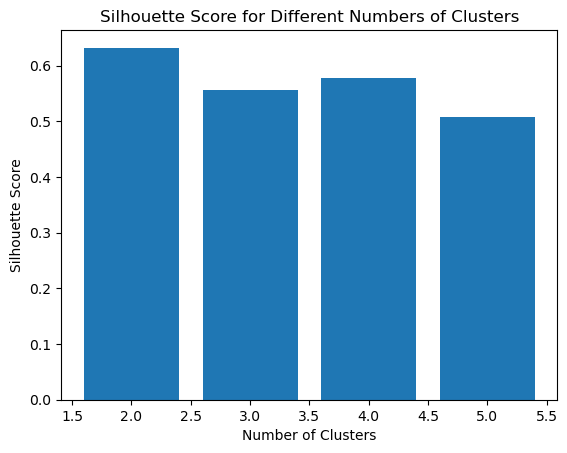

In [ ]:
# Menentukan jumlah clusters optimal (silhouette score)

from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans

def generate_silhouette(X, in_X_tfidf, n_clusters):
  silhouette_scores = []
  for i in range(2,n_clusters+1):
    # Clustering
    in_model = KMeans(n_clusters=i, random_state=42, n_init=10)
    in_y_pred = in_model.fit_predict(X)
    in_cluster_ids = set(in_y_pred)
    silhouette_avg = silhouette_score(X, in_y_pred)
    silhouette_scores.append(silhouette_avg)
    print("For n_clusters =", i, "The average silhouette_score is :", silhouette_avg)

  plt.bar(range(2,n_clusters+1), silhouette_scores)
  plt.xlabel("Number of Clusters")
  plt.ylabel("Silhouette Score")
  plt.title("Silhouette Score for Different Numbers of Clusters")
  plt.show()

silhouette_predict = generate_silhouette(X_svd, matrix_tfidf, 5)

# n_clusters = 2

In [ ]:
# Clusterin dengan K-Means
k = 2
km = KMeans(n_clusters=k, init='k-means++', max_iter=100, n_init=50,
                verbose=1)
in_y_pred = km.fit_predict(X_svd)
silhouette_avg = silhouette_score(X_svd, in_y_pred)
print("The average silhouette_score is :", silhouette_avg)

Initialization complete
Iteration 0, inertia 105.88861666759028.
Iteration 1, inertia 79.04510689219494.
Iteration 2, inertia 73.87655779304612.
Iteration 3, inertia 71.78831795517229.
Iteration 4, inertia 71.12549116320736.
Iteration 5, inertia 70.56649561465802.
Iteration 6, inertia 70.39823834355869.
Iteration 7, inertia 70.35821263072249.
Iteration 8, inertia 70.3179635814801.
Iteration 9, inertia 70.29261722261084.
Iteration 10, inertia 70.26358483182923.
Iteration 11, inertia 70.26122063732848.
Converged at iteration 11: center shift 1.6633273268281082e-06 within tolerance 2.6325967639453534e-06.
Initialization complete
Iteration 0, inertia 82.24784854136979.
Iteration 1, inertia 78.7261025470046.
Iteration 2, inertia 74.0376488821329.
Iteration 3, inertia 71.68930420271047.
Iteration 4, inertia 71.08422241091571.
Iteration 5, inertia 70.56406213800932.
Iteration 6, inertia 70.39924473659246.
Iteration 7, inertia 70.35821263072249.
Iteration 8, inertia 70.31796358148009.
Iteratio

In [ ]:
# Mencari top terms setiap clusters

# !pip3 install -U mlxtend
from mlxtend.frequent_patterns import fpgrowth
word_positions = {v: k for k, v in tfidf_vectorizer.vocabulary_.items()}
cluster_ids = set(in_y_pred)
min_support = 0.01
dist_words = sorted(v for k, v in word_positions.items()) # distinct words in the vocabulary

for cluster_id in cluster_ids:
    print(f"FP-Growth results on Cluster {cluster_id} with min support {min_support}")
    tfidf = matrix_tfidf[in_y_pred == cluster_id]
    # encoded as binary "presence/absence" representation as required by mlxtend
    tfidf[tfidf > 0] = 1
    # df is a pandas sparse dataframe
    df = pd.DataFrame.sparse.from_spmatrix(tfidf, columns=dist_words)
    fset = fpgrowth(df, min_support=min_support, use_colnames=True).sort_values(by='support', ascending=False)
    print(fset, '\n')

FP-Growth results on Cluster 0 with min support 0.01
      support              itemsets
17   0.334628                (data)
59   0.167071              (server)
38   0.145702               (input)
4    0.139874              (update)
184  0.104420         (input, data)
..        ...                   ...
209  0.010199          (data, menu)
224  0.010199        (admin, input)
57   0.010199                 (sah)
213  0.010199  (input, data, hasil)
222  0.010199       (input, kosong)

[253 rows x 2 columns] 

FP-Growth results on Cluster 1 with min support 0.01
      support              itemsets
0    0.798077                (eror)
1    0.548077              (server)
49   0.346154        (eror, server)
10   0.230769                (data)
108  0.230769          (eror, data)
..        ...                   ...
152  0.014423  (eror, admin, input)
154  0.014423        (buka, server)
155  0.014423         (buka, input)
157  0.014423  (eror, buka, server)
311  0.014423          (eror, edit)

[31

/home/mighfar/anaconda3/lib/python3.11/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(
/home/mighfar/anaconda3/lib/python3.11/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


/home/mighfar/anaconda3/lib/python3.11/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


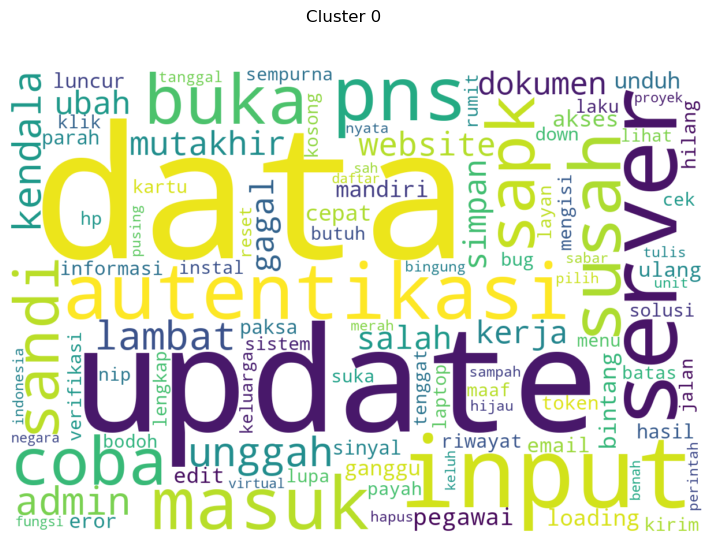

/home/mighfar/anaconda3/lib/python3.11/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


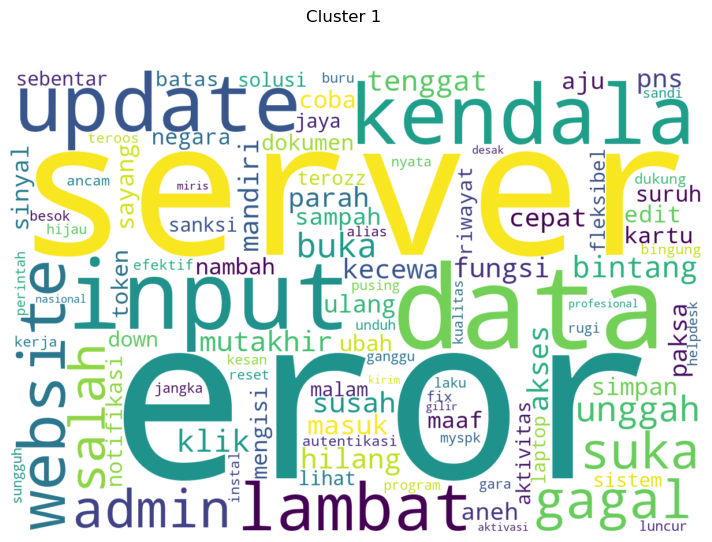

In [ ]:
# Visualisasi wordcloud

# !pip3 install -U wordcloud
from wordcloud import WordCloud
in_cluster_ids = set(in_y_pred)
top_count = 100

for in_cluster_id in in_cluster_ids:
  # compute the total tfidf for each term in the cluster
  in_tfidf = matrix_tfidf[in_y_pred == in_cluster_id]
  # numpy.matrix
  tfidf_sum = np.sum(in_tfidf, axis=0)
  # numpy.array of shape (1, X.shape[1])
  tfidf_sum = np.asarray(tfidf_sum).reshape(-1)
  top_indices = tfidf_sum.argsort()[-top_count:]
  term_weights = {word_positions[in_idx]: tfidf_sum[in_idx] for in_idx in top_indices}
  wc = WordCloud(width=1200, height=800, background_color="white")
  wordcloud = wc.generate_from_frequencies(term_weights)
  fig, ax = plt.subplots(figsize=(10, 6), dpi=100)
  ax.imshow(wordcloud, interpolation='bilinear')
  ax.axis("off")
  fig.suptitle(f"Cluster {in_cluster_id}")
  plt.show()

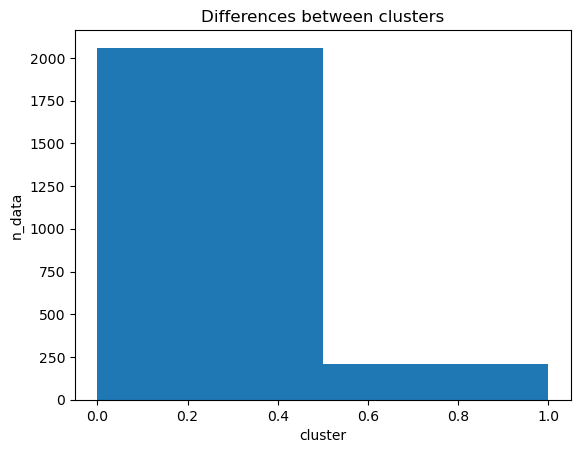

In [ ]:
# Visualisasi n_data per clusters

import matplotlib.pyplot as plt
%matplotlib inline

plt.hist(in_y_pred, bins=k)
plt.xlabel("cluster")
plt.ylabel("n_data")
plt.title("Differences between clusters")
plt.show()

In [ ]:
unique, counts = np.unique(in_y_pred, return_counts = True)
print(np.asarray((unique, counts)).T)

[[   0 2059]
 [   1  208]]


In [ ]:
in_y_pred

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

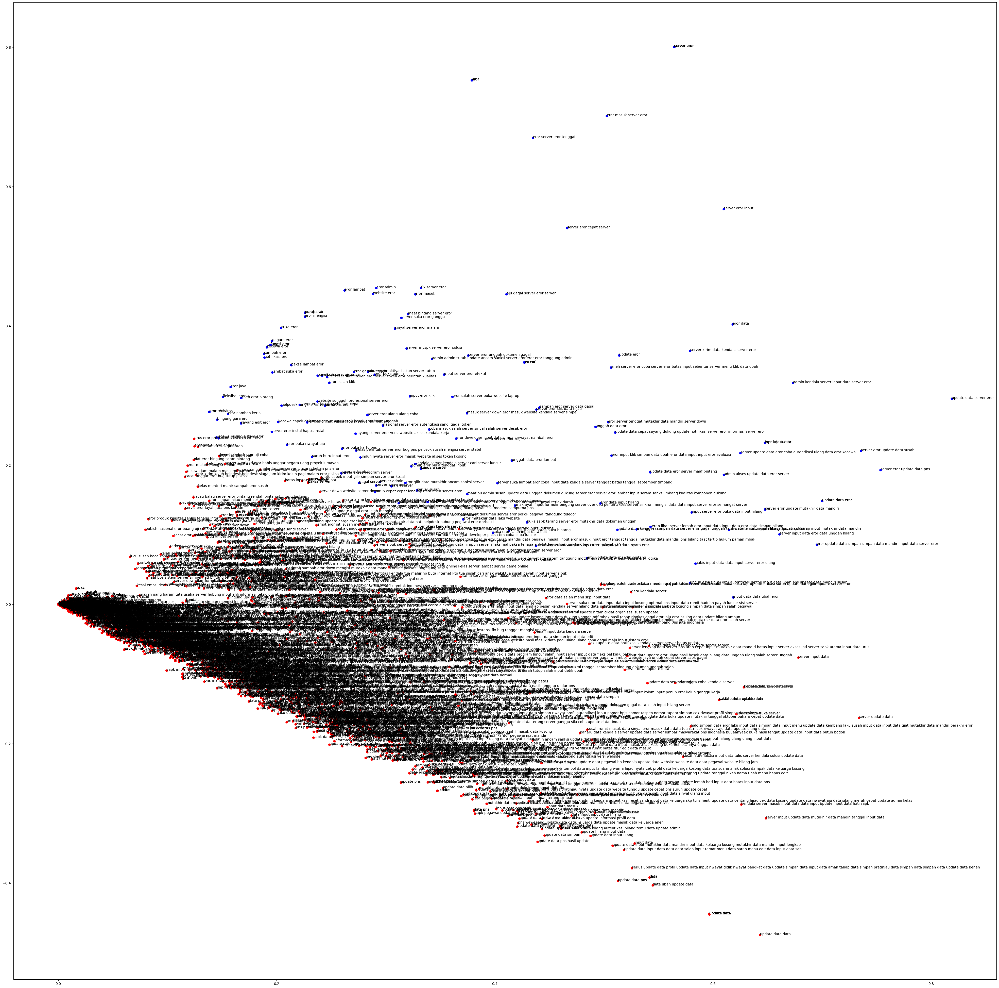

In [ ]:
# plotting all clusters

colors = ['r', 'b', 'y']

x_axis = [o[0] for o in X_svd]
y_axis = [o[1] for o in X_svd]

fig, ax = plt.subplots(figsize=(50, 50))

ax.scatter(x_axis, y_axis, c=[colors[d] for d in in_y_pred])

for i, txt in enumerate(data_text['content']):
  ax.annotate(txt, (x_axis[i],y_axis[i]))
plt.show()

In [ ]:
cluster_assignments_dict = {}

for i in set(km.labels_):
    #print i
    current_cluster = [data_text['content'][x] for x in np.where(km.labels_ == i)[0]]
    cluster_assignments_dict[i] = current_cluster

KeyError: ignored

In [ ]:
print('Cluster {0}'.format(0))
cluster_assignments_dict[0]

Cluster 0


KeyError: ignored

# n_clusters = 3

In [ ]:
# Clusterin dengan K-Means
k2 = 3
km2 = KMeans(n_clusters=k2, init='k-means++', max_iter=100, n_init=50,
                verbose=1)
in_y_pred2 = km2.fit_predict(X_svd)
silhouette_avg2 = silhouette_score(X_svd, in_y_pred2)
print("The average silhouette_score is :", silhouette_avg2)

Initialization complete
Iteration 0, inertia 61.00553189496651.
Iteration 1, inertia 41.62429255811857.
Iteration 2, inertia 38.725535515712686.
Iteration 3, inertia 38.00340590018941.
Iteration 4, inertia 37.853364280180905.
Iteration 5, inertia 37.833354392922395.
Iteration 6, inertia 37.82882700127835.
Iteration 7, inertia 37.81505912600914.
Iteration 8, inertia 37.81012900669439.
Iteration 9, inertia 37.80161130948124.
Iteration 10, inertia 37.79641753801185.
Iteration 11, inertia 37.79376315763286.
Converged at iteration 11: center shift 8.415433229842075e-08 within tolerance 2.6325226376873567e-06.
Initialization complete
Iteration 0, inertia 49.60058320428642.
Iteration 1, inertia 38.678763493091864.
Iteration 2, inertia 38.034655919793536.
Iteration 3, inertia 37.8408154490518.
Iteration 4, inertia 37.804444385682274.
Iteration 5, inertia 37.79488125484985.
Converged at iteration 5: center shift 1.3104200623533662e-06 within tolerance 2.6325226376873567e-06.
Initialization comp

In [ ]:
# Mencari top terms setiap clusters

# !pip3 install -U mlxtend
from mlxtend.frequent_patterns import fpgrowth
word_positions2 = {v: k for k, v in tfidf_vectorizer.vocabulary_.items()}
cluster_ids2 = set(in_y_pred2)
min_support2 = 0.01
dist_words2 = sorted(v for k, v in word_positions2.items()) # distinct words in the vocabulary

for cluster_id in cluster_ids2:
    print(f"FP-Growth results on Cluster {cluster_id} with min support {min_support2}")
    tfidf2 = matrix_tfidf[in_y_pred2 == cluster_id]
    # encoded as binary "presence/absence" representation as required by mlxtend
    tfidf2[tfidf2 > 0] = 1
    # df is a pandas sparse dataframe
    df2 = pd.DataFrame.sparse.from_spmatrix(tfidf2, columns=dist_words2)
    fset2 = fpgrowth(df2, min_support=min_support2, use_colnames=True).sort_values(by='support', ascending=False)
    print(fset2, '\n')

FP-Growth results on Cluster 0 with min support 0.01


/home/mighfar/anaconda3/lib/python3.11/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


      support          itemsets
0    0.909263            (data)
1    0.419660          (update)
12   0.364839           (input)
103  0.349716    (update, data)
203  0.344045     (input, data)
..        ...               ...
96   0.011342           (habis)
92   0.011342            (down)
91   0.011342          (tunggu)
509  0.011342  (simpan, unggah)
747  0.011342    (bilang, data)

[748 rows x 2 columns] 

FP-Growth results on Cluster 1 with min support 0.01
      support              itemsets
51   0.143600              (server)
16   0.139701                (data)
32   0.078622                 (pns)
0    0.076673         (autentikasi)
56   0.073424               (input)
..        ...                   ...
130  0.010396         (susah, data)
128  0.010396  (susah, autentikasi)
89   0.010396                (hati)
14   0.010396              (respon)
100  0.010396               (sibuk)

[145 rows x 2 columns] 

FP-Growth results on Cluster 2 with min support 0.01


/home/mighfar/anaconda3/lib/python3.11/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(
/home/mighfar/anaconda3/lib/python3.11/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


      support                itemsets
0    0.788945                  (eror)
1    0.557789                (server)
65   0.346734          (eror, server)
12   0.206030                  (data)
154  0.206030            (eror, data)
..        ...                     ...
272  0.010050  (sandi, server, token)
271  0.010050           (eror, sandi)
270  0.010050         (sandi, server)
269  0.010050          (sandi, token)
620  0.010050            (eror, edit)

[621 rows x 2 columns] 



/home/mighfar/anaconda3/lib/python3.11/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


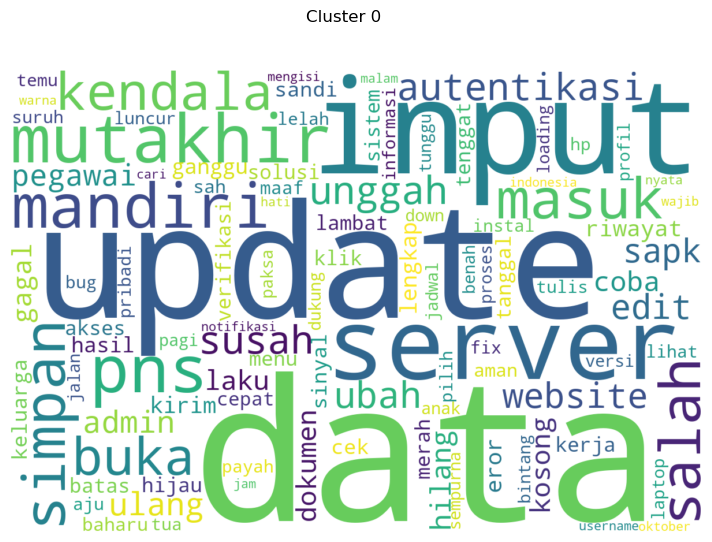

/home/mighfar/anaconda3/lib/python3.11/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


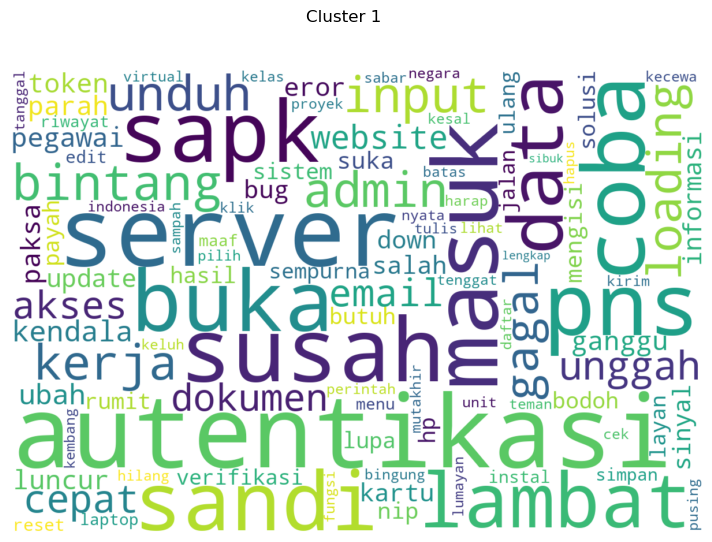

/home/mighfar/anaconda3/lib/python3.11/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


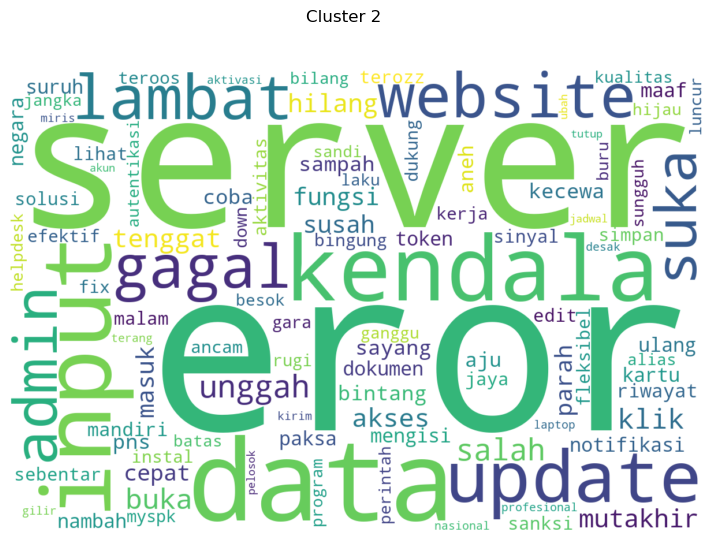

In [ ]:
from wordcloud import WordCloud
in_cluster_ids2 = set(in_y_pred2)
top_count2 = 100

for in_cluster_id in in_cluster_ids2:
  # compute the total tfidf for each term in the cluster
  in_tfidf2 = matrix_tfidf[in_y_pred2 == in_cluster_id]
  # numpy.matrix
  tfidf_sum2 = np.sum(in_tfidf2, axis=0)
  # numpy.array of shape (1, X.shape[1])
  tfidf_sum2 = np.asarray(tfidf_sum2).reshape(-1)
  top_indices2 = tfidf_sum2.argsort()[-top_count2:]
  term_weights2 = {word_positions2[in_idx]: tfidf_sum2[in_idx] for in_idx in top_indices2}
  wc2 = WordCloud(width=1200, height=800, background_color="white")
  wordcloud2 = wc2.generate_from_frequencies(term_weights2)
  fig, ax = plt.subplots(figsize=(10, 6), dpi=100)
  ax.imshow(wordcloud2, interpolation='bilinear')
  ax.axis("off")
  fig.suptitle(f"Cluster {in_cluster_id}")
  plt.show()

In [ ]:
for in_cluster_id in in_cluster_ids2:
  # compute the total tfidf for each term in the cluster
  in_tfidf2 = matrix_tfidf[in_y_pred2 == in_cluster_id]
  # numpy.matrix
  tfidf_sum2 = np.sum(in_tfidf2, axis=0)
  # numpy.array of shape (1, X.shape[1])
  tfidf_sum2 = np.asarray(tfidf_sum2).reshape(-1)
  top_indices2 = tfidf_sum2.argsort()[-top_count2:]
  term_weights2 = {word_positions2[in_idx]: tfidf_sum2[in_idx] for in_idx in top_indices2}
  print(term_weights2)

{'oktober': 2.2026084805357145, 'warna': 2.210017451796805, 'notifikasi': 2.2650257077171156, 'cari': 2.2740345201542462, 'indonesia': 2.2769193915391357, 'username': 2.32995552130126, 'jam': 2.331084992616653, 'wajib': 2.3889923096632013, 'malam': 2.4078921894586522, 'hati': 2.460220459843168, 'nyata': 2.463479516689502, 'mengisi': 2.4892742237452476, 'benah': 2.49389860188966, 'sempurna': 2.5712153551219004, 'tunggu': 2.643719410180716, 'versi': 2.693185117636599, 'loading': 2.715660324986775, 'paksa': 2.729435542249214, 'proses': 2.736451654657533, 'jalan': 2.73737276665945, 'jadwal': 2.7422897905461485, 'anak': 2.7485608517051365, 'down': 2.775713259517636, 'pagi': 2.805981393185349, 'dukung': 2.8198876551965277, 'profil': 2.847023405984783, 'bintang': 2.9096911604062465, 'luncur': 3.043219909194511, 'aju': 3.0542986147294764, 'hp': 3.0547274411290912, 'fix': 3.0772114046570493, 'bug': 3.100391889798729, 'payah': 3.1378001729729084, 'instal': 3.1935442502493707, 'tua': 3.2337978413

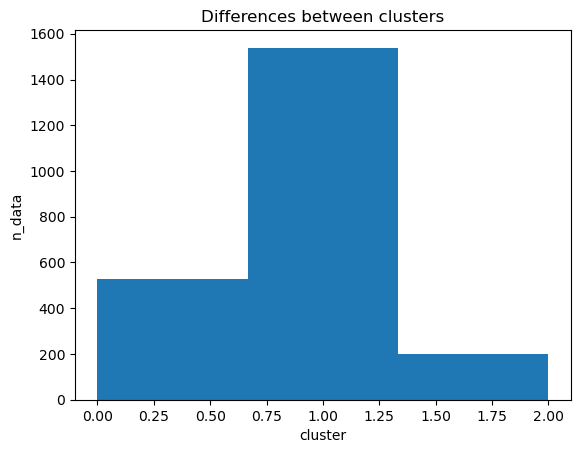

In [ ]:
# Visualisasi n_data per clusters

import matplotlib.pyplot as plt
%matplotlib inline

plt.hist(in_y_pred2, bins=k2)
plt.xlabel("cluster")
plt.ylabel("n_data")
plt.title("Differences between clusters")
plt.show()

In [ ]:
unique2, counts2 = np.unique(in_y_pred2, return_counts = True)
print(np.asarray((unique2, counts2)).T)

[[   0  529]
 [   1 1539]
 [   2  199]]


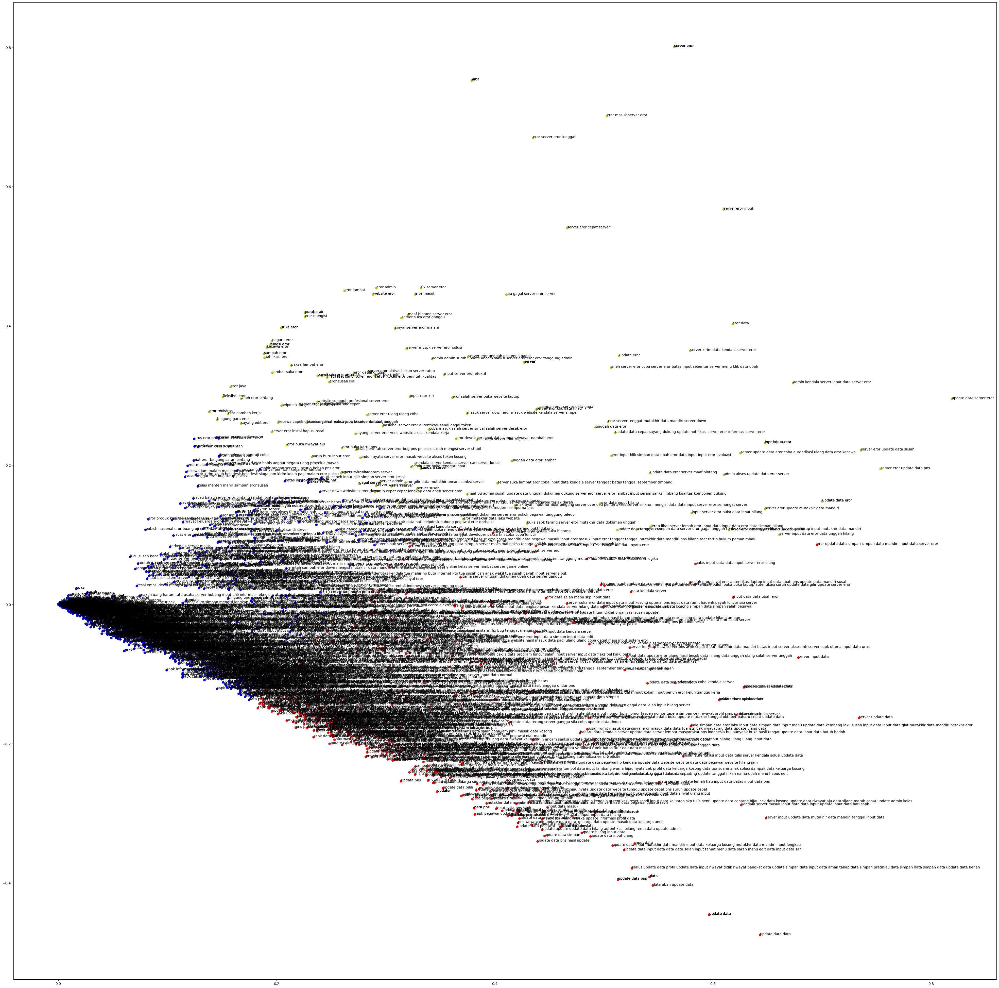

In [ ]:
# plotting all clusters

colors = ['r', 'b', 'y']

x_axis = [o[0] for o in X_svd]
y_axis = [o[1] for o in X_svd]

fig, ax = plt.subplots(figsize=(50, 50))

ax.scatter(x_axis, y_axis, c=[colors[d] for d in in_y_pred2])

for i, txt in enumerate(data_text['content']):
  ax.annotate(txt, (x_axis[i],y_axis[i]))
plt.show()

# n_clusters = 4

In [ ]:
# Clusterin dengan K-Means
k3 = 4
km3 = KMeans(n_clusters=k3, init='k-means++', max_iter=100, n_init=50,
                verbose=1)
in_y_pred3 = km3.fit_predict(X_svd)
silhouette_avg3 = silhouette_score(X_svd, in_y_pred3)
print("The average silhouette_score is :", silhouette_avg3)

Initialization complete
Iteration 0, inertia 42.94540278646537.
Iteration 1, inertia 34.29628513901521.
Iteration 2, inertia 32.34983370511779.
Iteration 3, inertia 31.539007052122336.
Iteration 4, inertia 31.246321796480565.
Iteration 5, inertia 31.18584752209789.
Iteration 6, inertia 31.126244697951158.
Iteration 7, inertia 31.0687569292708.
Iteration 8, inertia 31.05186441265146.
Iteration 9, inertia 31.04247327458023.
Iteration 10, inertia 31.039008611433996.
Converged at iteration 10: center shift 4.26347400022043e-07 within tolerance 2.6325967639453534e-06.
Initialization complete
Iteration 0, inertia 44.12742355809914.
Iteration 1, inertia 32.710978032772644.
Iteration 2, inertia 31.726278725954376.
Iteration 3, inertia 31.42960823108973.
Iteration 4, inertia 31.24542432944387.
Iteration 5, inertia 31.14470481938242.
Iteration 6, inertia 31.06416677619315.
Iteration 7, inertia 31.02270197352379.
Iteration 8, inertia 31.007568844421293.
Iteration 9, inertia 31.004807354728964.
Co

In [ ]:
# Mencari top terms setiap clusters

# !pip3 install -U mlxtend
#from mlxtend.frequent_patterns import fpgrowth
word_positions3 = {v: k for k, v in tfidf_vectorizer.vocabulary_.items()}
cluster_ids3 = set(in_y_pred3)
min_support3 = 0.01
dist_words3 = sorted(v for k, v in word_positions3.items()) # distinct words in the vocabulary

for cluster_id in cluster_ids3:
    print(f"FP-Growth results on Cluster {cluster_id} with min support {min_support3}")
    tfidf3 = matrix_tfidf[in_y_pred3 == cluster_id]
    # encoded as binary "presence/absence" representation as required by mlxtend
    tfidf3[tfidf3 > 0] = 1
    # df is a pandas sparse dataframe
    df3 = pd.DataFrame.sparse.from_spmatrix(tfidf3, columns=dist_words3)
    fset3 = fpgrowth(df3, min_support=min_support3, use_colnames=True).sort_values(by='support', ascending=False)
    print(fset3, '\n')

FP-Growth results on Cluster 0 with min support 0.01


/home/mighfar/anaconda3/lib/python3.11/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


      support         itemsets
15   0.132505           (data)
50   0.113872         (server)
0    0.078675    (autentikasi)
31   0.075914            (pns)
10   0.073154          (masuk)
..        ...              ...
119  0.010352    (email, lupa)
104  0.010352  (masuk, server)
113  0.010352  (pegawai, data)
108  0.010352    (coba, sandi)
123  0.010352      (data, pns)

[138 rows x 2 columns] 

FP-Growth results on Cluster 1 with min support 0.01
      support                       itemsets
4    0.668067                       (server)
0    0.655462                         (eror)
82   0.323529                 (eror, server)
1    0.285714                         (data)
83   0.273109                   (eror, data)
..        ...                            ...
383  0.012605          (input, unggah, data)
384  0.012605        (unggah, input, server)
385  0.012605          (eror, unggah, input)
386  0.012605  (input, unggah, data, server)
567  0.012605                   (eror, edit)

[568 row

/home/mighfar/anaconda3/lib/python3.11/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(
/home/mighfar/anaconda3/lib/python3.11/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(
/home/mighfar/anaconda3/lib/python3.11/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


     support                 itemsets
0   1.000000                   (eror)
6   0.277778           (eror, server)
1   0.277778                 (server)
11  0.018519            (eror, input)
17  0.018519          (eror, tenggat)
16  0.018519        (tenggat, server)
15  0.018519    (eror, server, cepat)
14  0.018519            (eror, cepat)
13  0.018519          (server, cepat)
12  0.018519    (eror, input, server)
9   0.018519    (eror, masuk, server)
10  0.018519          (input, server)
8   0.018519            (eror, masuk)
7   0.018519          (masuk, server)
5   0.018519                (tenggat)
4   0.018519                  (cepat)
3   0.018519                  (input)
2   0.018519                  (masuk)
18  0.018519  (eror, tenggat, server) 



/home/mighfar/anaconda3/lib/python3.11/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


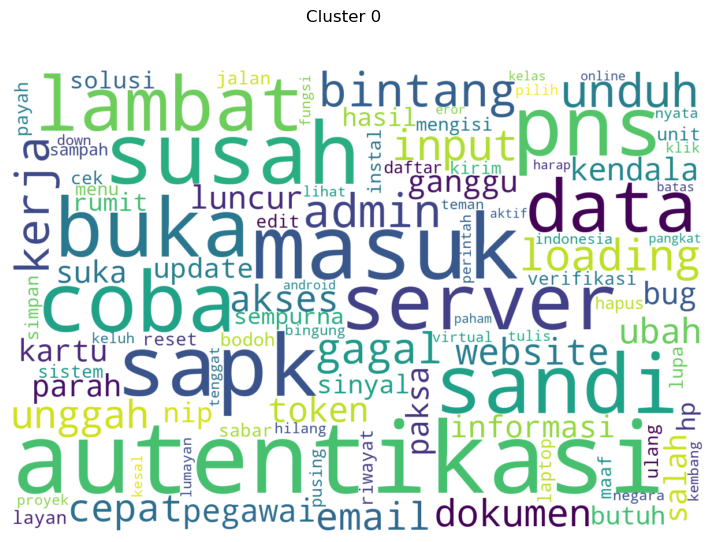

/home/mighfar/anaconda3/lib/python3.11/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


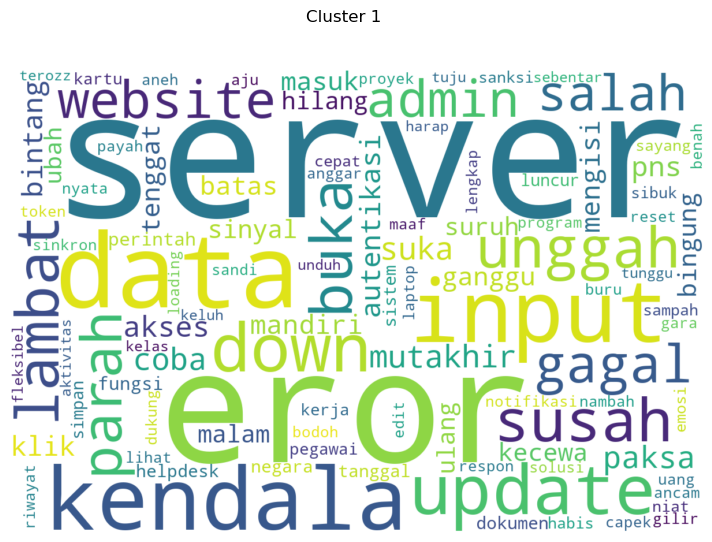

/home/mighfar/anaconda3/lib/python3.11/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


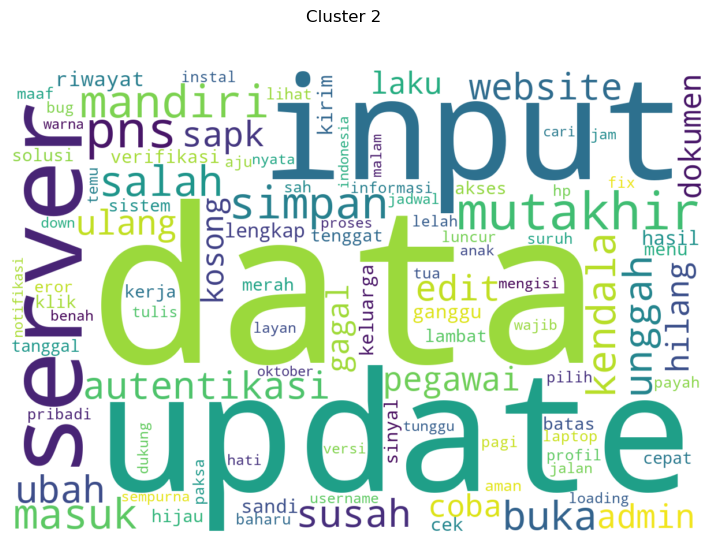

/home/mighfar/anaconda3/lib/python3.11/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


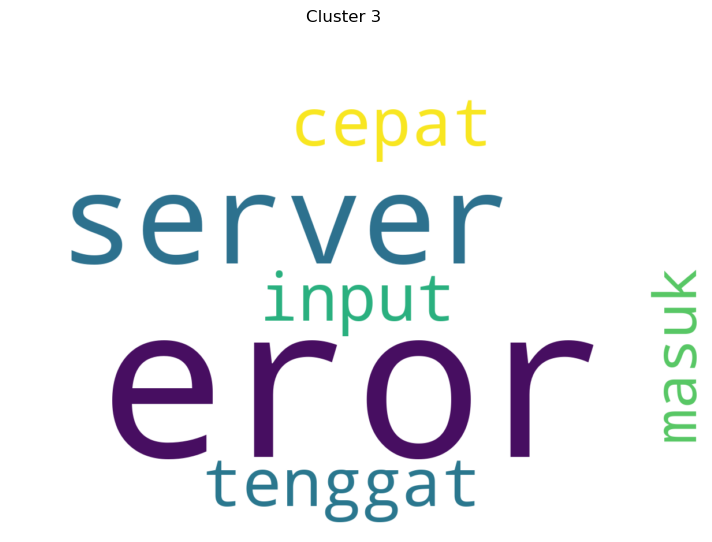

In [ ]:
#from wordcloud import WordCloud
in_cluster_ids3 = set(in_y_pred3)
top_count3 = 100

for in_cluster_id in in_cluster_ids3:
  # compute the total tfidf for each term in the cluster
  in_tfidf3 = matrix_tfidf[in_y_pred3 == in_cluster_id]
  # numpy.matrix
  tfidf_sum3 = np.sum(in_tfidf3, axis=0)
  # numpy.array of shape (1, X.shape[1])
  tfidf_sum3 = np.asarray(tfidf_sum3).reshape(-1)
  top_indices3 = tfidf_sum3.argsort()[-top_count3:]
  term_weights3 = {word_positions3[in_idx]: tfidf_sum3[in_idx] for in_idx in top_indices3}
  wc3 = WordCloud(width=1200, height=800, background_color="white")
  wordcloud3 = wc3.generate_from_frequencies(term_weights3)
  fig, ax = plt.subplots(figsize=(10, 6), dpi=100)
  ax.imshow(wordcloud3, interpolation='bilinear')
  ax.axis("off")
  fig.suptitle(f"Cluster {in_cluster_id}")
  plt.show()

In [ ]:
unique3, counts3 = np.unique(in_y_pred3, return_counts = True)
print(np.asarray((unique3, counts3)).T)

[[   0 1449]
 [   1  238]
 [   2  526]
 [   3   54]]


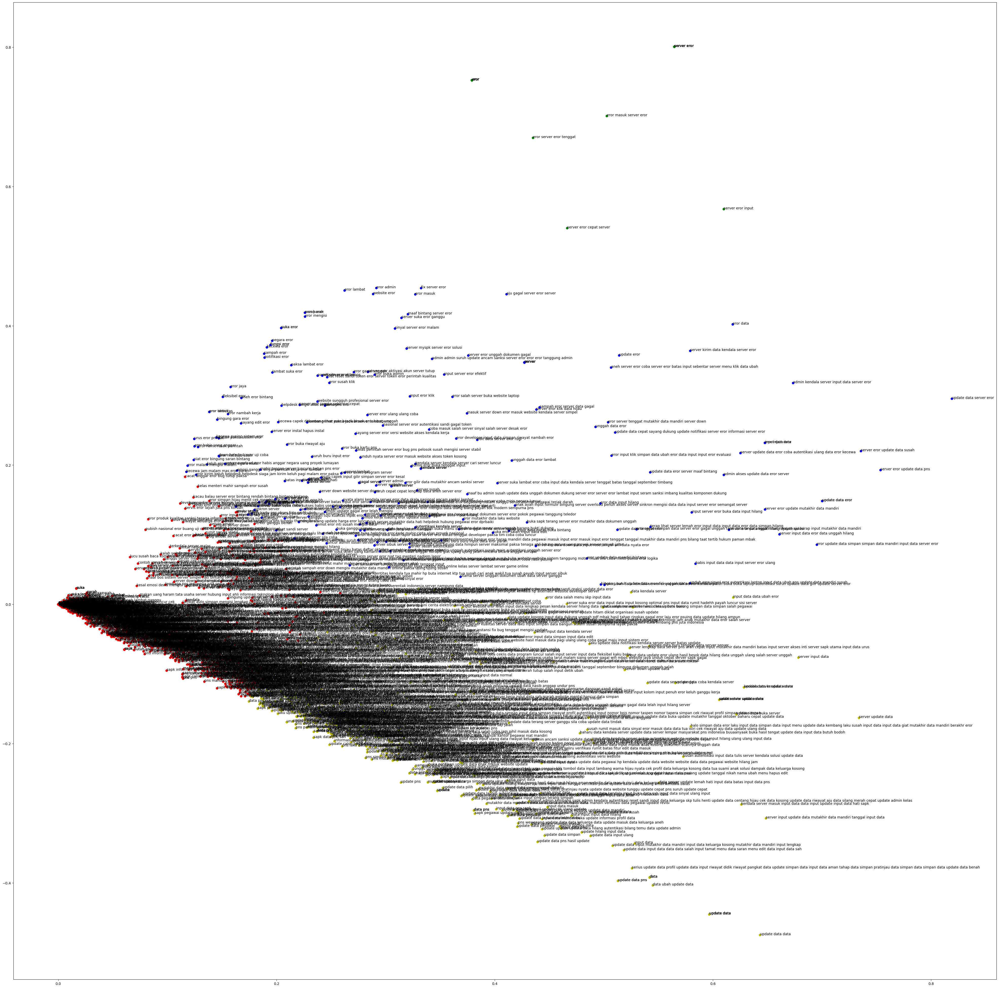

In [ ]:
# plotting all clusters

colors = ['r', 'b', 'y', 'g']

x_axis = [o[0] for o in X_svd]
y_axis = [o[1] for o in X_svd]

fig, ax = plt.subplots(figsize=(50, 50))

ax.scatter(x_axis, y_axis, c=[colors[d] for d in in_y_pred3])

for i, txt in enumerate(data_text['content']):
  ax.annotate(txt, (x_axis[i],y_axis[i]))
plt.show()

# n_clusters = 5

In [ ]:
# Clusterin dengan K-Means
k4 = 5
km4 = KMeans(n_clusters=k4, init='k-means++', max_iter=100, n_init=50,
                verbose=1)
in_y_pred4 = km4.fit_predict(X_svd)
silhouette_avg4 = silhouette_score(X_svd, in_y_pred4)
print("The average silhouette_score is :", silhouette_avg4)

Initialization complete
Iteration 0, inertia 29.883454380211013.
Iteration 1, inertia 24.410028078455674.
Iteration 2, inertia 23.171758120042757.
Iteration 3, inertia 22.78551191466822.
Iteration 4, inertia 22.70260518258472.
Iteration 5, inertia 22.681443443872077.
Iteration 6, inertia 22.666007969361633.
Iteration 7, inertia 22.662982849833043.
Iteration 8, inertia 22.660328986981096.
Iteration 9, inertia 22.658669349072063.
Converged at iteration 9: center shift 1.2155669401612638e-06 within tolerance 2.6325967639453534e-06.
Initialization complete
Iteration 0, inertia 26.474997403783522.
Iteration 1, inertia 22.916483172179735.
Iteration 2, inertia 22.401768293800366.
Iteration 3, inertia 22.11734948929289.
Iteration 4, inertia 21.77347262430966.
Iteration 5, inertia 21.4370514068318.
Iteration 6, inertia 21.120852396117893.
Iteration 7, inertia 20.962097506400525.
Iteration 8, inertia 20.840915255280457.
Iteration 9, inertia 20.764836042170792.
Iteration 10, inertia 20.7009745018

In [ ]:
# Mencari top terms setiap clusters

# !pip3 install -U mlxtend
#from mlxtend.frequent_patterns import fpgrowth
word_positions4 = {v: k for k, v in tfidf_vectorizer.vocabulary_.items()}
cluster_ids4 = set(in_y_pred4)
min_support4 = 0.01
dist_words4 = sorted(v for k, v in word_positions4.items()) # distinct words in the vocabulary

for cluster_id in cluster_ids4:
    print(f"FP-Growth results on Cluster {cluster_id} with min support {min_support4}")
    tfidf4 = matrix_tfidf[in_y_pred4 == cluster_id]
    # encoded as binary "presence/absence" representation as required by mlxtend
    tfidf4[tfidf4 > 0] = 1
    # df is a pandas sparse dataframe
    df4 = pd.DataFrame.sparse.from_spmatrix(tfidf4, columns=dist_words4)
    fset4 = fpgrowth(df4, min_support=min_support4, use_colnames=True).sort_values(by='support', ascending=False)
    print(fset4, '\n')

FP-Growth results on Cluster 0 with min support 0.01
     support       itemsets
45  0.099832       (server)
25  0.070470          (pns)
8   0.063758        (sandi)
0   0.061242  (autentikasi)
9   0.057886        (masuk)
..       ...            ...
34  0.010067       (dukung)
33  0.010067         (unit)
85  0.010067         (guru)
70  0.010067     (kualitas)
59  0.010067          (uji)

[114 rows x 2 columns] 

FP-Growth results on Cluster 1 with min support 0.01


/home/mighfar/anaconda3/lib/python3.11/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(
/home/mighfar/anaconda3/lib/python3.11/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(
/home/mighfar/anaconda3/lib/python3.11/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


      support                       itemsets
4    0.676230                       (server)
0    0.639344                         (eror)
81   0.315574                 (eror, server)
1    0.278689                         (data)
82   0.266393                   (eror, data)
..        ...                            ...
300  0.012295  (eror, update, admin, server)
299  0.012295        (update, admin, server)
298  0.012295          (eror, update, admin)
295  0.012295                  (admin, data)
544  0.012295                   (eror, edit)

[545 rows x 2 columns] 

FP-Growth results on Cluster 2 with min support 0.01
      support                       itemsets
0    0.930131                         (data)
1    0.580786                       (update)
82   0.510917                 (update, data)
196  0.349345                  (input, data)
11   0.349345                        (input)
..        ...                            ...
427  0.013100                  (buka, masuk)
424  0.013100  (updat

/home/mighfar/anaconda3/lib/python3.11/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(
/home/mighfar/anaconda3/lib/python3.11/site-packages/mlxtend/frequent_patterns/fpcommon.py:110: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


/home/mighfar/anaconda3/lib/python3.11/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


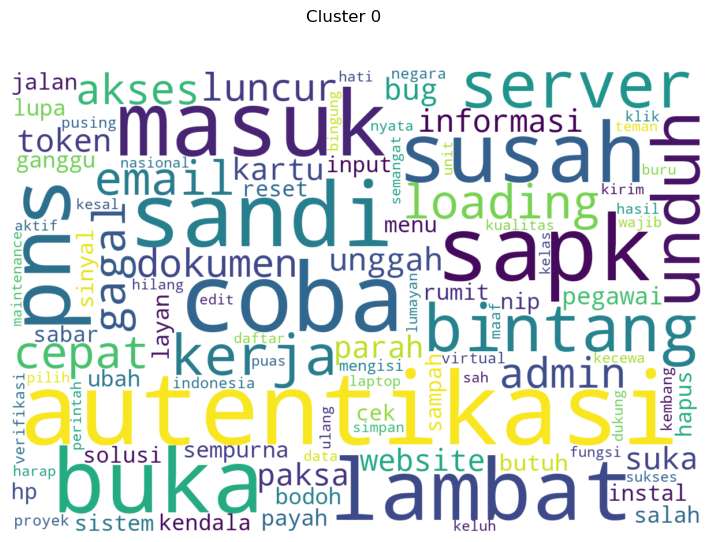

/home/mighfar/anaconda3/lib/python3.11/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


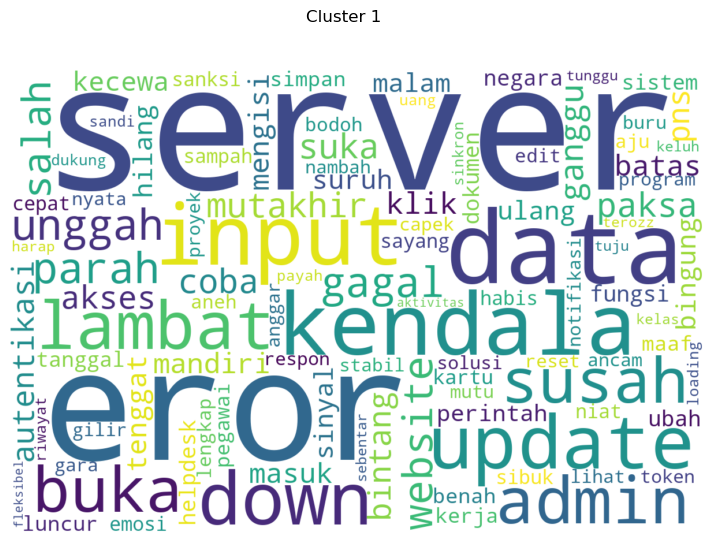

/home/mighfar/anaconda3/lib/python3.11/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


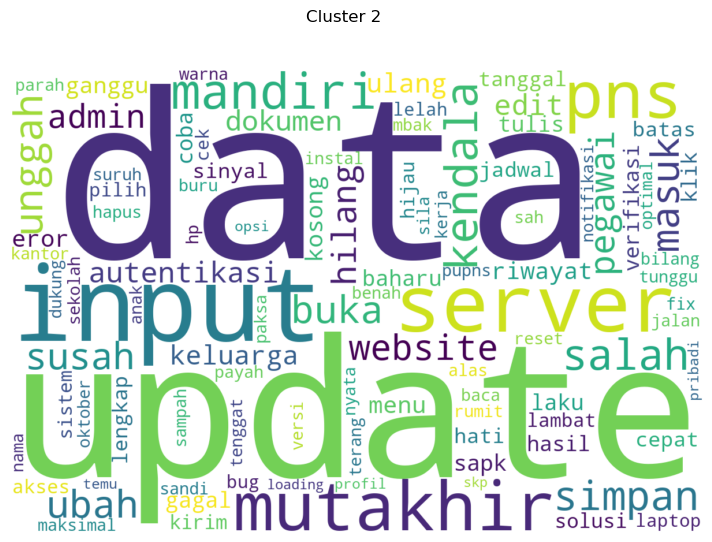

/home/mighfar/anaconda3/lib/python3.11/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


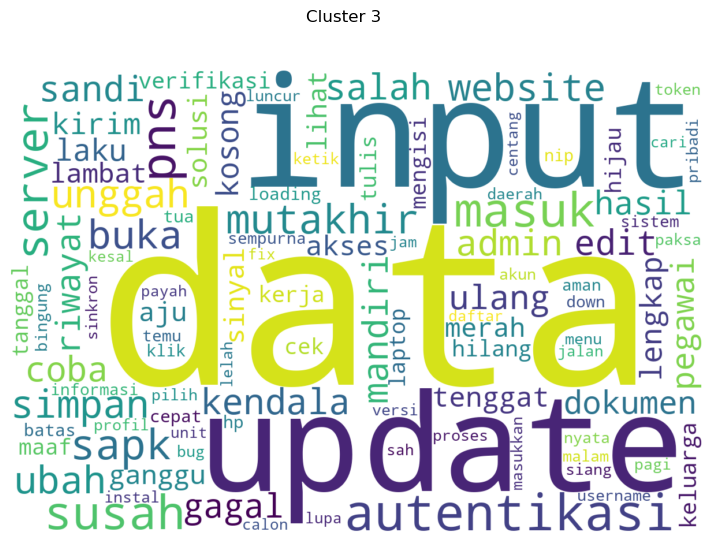

/home/mighfar/anaconda3/lib/python3.11/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)


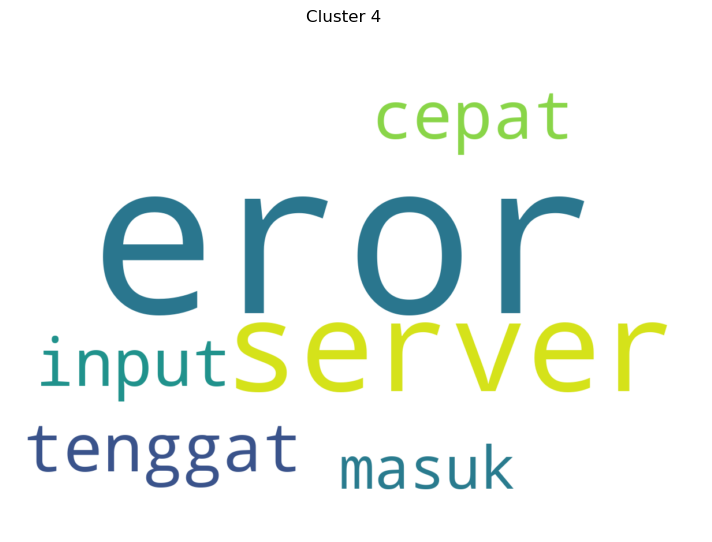

In [ ]:
#from wordcloud import WordCloud
in_cluster_ids4 = set(in_y_pred4)
top_count4 = 100

for in_cluster_id in in_cluster_ids4:
  # compute the total tfidf for each term in the cluster
  in_tfidf4 = matrix_tfidf[in_y_pred4 == in_cluster_id]
  # numpy.matrix
  tfidf_sum4 = np.sum(in_tfidf4, axis=0)
  # numpy.array of shape (1, X.shape[1])
  tfidf_sum4 = np.asarray(tfidf_sum4).reshape(-1)
  top_indices4 = tfidf_sum4.argsort()[-top_count4:]
  term_weights4 = {word_positions4[in_idx]: tfidf_sum4[in_idx] for in_idx in top_indices4}
  wc4 = WordCloud(width=1200, height=800, background_color="white")
  wordcloud4 = wc4.generate_from_frequencies(term_weights4)
  fig, ax = plt.subplots(figsize=(10, 6), dpi=100)
  ax.imshow(wordcloud4, interpolation='bilinear')
  ax.axis("off")
  fig.suptitle(f"Cluster {in_cluster_id}")
  plt.show()

In [ ]:
unique4, counts4 = np.unique(in_y_pred4, return_counts = True)
print(np.asarray((unique4, counts4)).T)

[[   0 1192]
 [   1  244]
 [   2  229]
 [   3  548]
 [   4   54]]


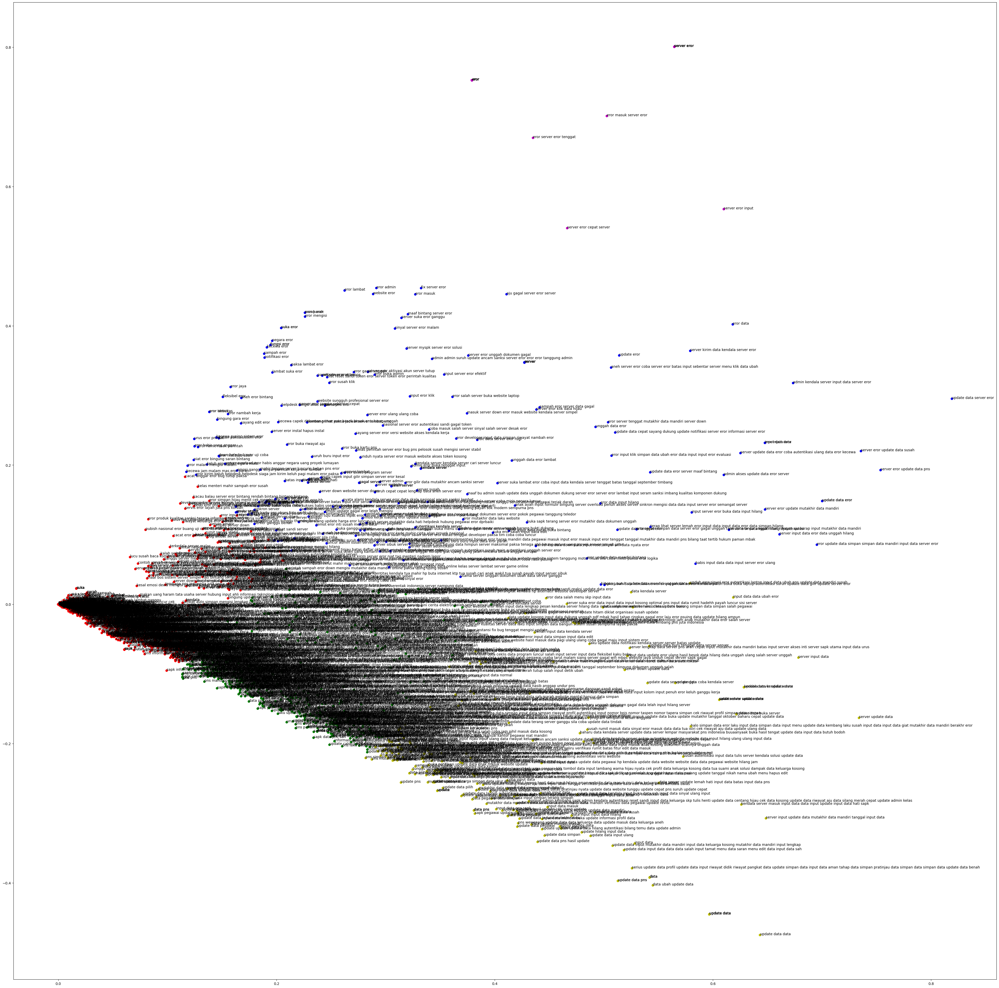

In [ ]:
# plotting all clusters

colors = ['r', 'b', 'y', 'g', 'm']

x_axis = [o[0] for o in X_svd]
y_axis = [o[1] for o in X_svd]

fig, ax = plt.subplots(figsize=(50, 50))

ax.scatter(x_axis, y_axis, c=[colors[d] for d in in_y_pred4])

for i, txt in enumerate(data_text['content']):
  ax.annotate(txt, (x_axis[i],y_axis[i]))
plt.show()

# Assign Label ke Raw Data

In [ ]:
data_text['cluster'] = in_y_pred2
data_text

/tmp/ipykernel_4589/4149589032.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_text['cluster'] = in_y_pred2


,content,cluster
0,keluh autentikasi,1
1,jalan,1
2,sapk,1
4,update entri versi website,1
5,bintang,1
...,...,...
3312,coba informasi,1
3315,email konfirmasi email,1
3316,menu registrasi daftar registrasi daftar menu ...,1
3319,mendukung mutakhir data pns ppt pns,1


In [ ]:
data_cluster = pd.concat([data, data_text], axis=1)
data_cluster

,userName,score,at,content,content,cluster
0,Syaidati Hartinah,1,2023-08-29 04:00:17,Saya komplain karna gk bisa login berkali kali,keluh autentikasi,1.0
1,Asep Samsul Umam,5,2023-08-28 14:24:23,"Sudah beberapa kali pembaruan, aplikasi berjal...",jalan,1.0
2,saep udin,5,2023-08-27 11:05:50,My sapk bkn sangat OK,sapk,1.0
3,ANDTARA _ DHIK4,5,2023-08-27 09:54:27,Oke Punya,NaN,NaN
4,Junaedi Tarihoran,1,2023-08-26 05:23:54,Mohon aplikasi di update untuk perbaikan tampi...,update entri versi website,1.0
...,...,...,...,...,...,...
3316,Ifin Marlonk,1,2021-07-15 04:43:19,"Apkikasinya gak ada menu registrasi/daftar, ma...",menu registrasi daftar registrasi daftar menu ...,1.0
3317,Engkos Kosasih,5,2021-07-15 02:39:14,P8😂😂💩😭😇🎂⁸dc😶😶g ⁹66🙏💦😅699cj⁸⁸on tar u6,NaN,NaN
3318,Karsinah Karsinah,4,2021-07-15 02:21:30,Sangat membantu,NaN,NaN
3319,alwi alwi,5,2021-07-15 01:18:16,"Sangat medukung dal hal pemutahiran data ASN, ...",mendukung mutakhir data pns ppt pns,1.0


In [ ]:
data_cluster.to_excel('Dataset_Clustering_Result.xlsx',  index=False, header = True)